In [1]:
%config InlineBackend.figure_format = "retina"

In [2]:
import warnings
warnings.filterwarnings("ignore")

In [4]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns

# Загрузка данных
## Сенсоры

In [5]:
import os
from datetime import datetime

DIR_PATH = "../Probe_Data/"

Data = pd.read_csv(os.path.join(DIR_PATH, "SensorsData_FebMarMay.csv"), index_col=0)
Data.index = np.array(
    ([datetime.strptime(d, '%Y-%m-%d %H:%M:%S') for d in Data.index]),
    dtype='datetime64[ns]')

stops_data = pd.read_csv(os.path.join(DIR_PATH, "Jan_to_Jun_StopLogs.csv"))
stops_data['start_datetime'] = stops_data.start_datetime.astype('datetime64[ns]')
stops_data['end_datetime'] = stops_data.end_datetime.astype('datetime64[ns]')

In [6]:
from sklearn.impute import SimpleImputer

Data.dropna(how='all', inplace=True)
imputer = SimpleImputer()
Data = pd.DataFrame(imputer.fit_transform(Data), index=Data.index, columns=Data.columns)

## Таргет

In [7]:
# Берем таргет из журнальных данных

Data['target'] = 0
Data['target_dscr'] = "Норма"

for start, end, dscr in stops_data[np.invert(stops_data.description.isin([
        "Технологические плановые : Межплавочный период",
        ]))]\
        [['start_datetime', 'end_datetime', 'description']].values:
    
    Data['target'][(Data.index >= start) & (Data.index <= end)] = 1
    Data['target_dscr'][(Data.index >= start) & (Data.index <= end)] = dscr

In [8]:
# Добавляем таргет по минимумам вибрации

Data["target"][(Data["Вибрация заднего подшипника двигателя (осевая)"] < 15.0)
             & (Data["Вибрация заднего подшипника двигателя (радиальная)"] < 15.0)] = 1

In [9]:

from copy import deepcopy

def SetShiftTarget(Data, delta):
    """
    Сдвигает изначальный таргет на delta шагов назад
    Шаг дискретизации по времени : 5 минут
    """
    Data["shift_target"] = deepcopy(Data.target.shift(-delta, fill_value=0).values)
    Data["shift_target"] = Data.shift_target.astype(int)
    return Data

# Смещаем на 240 шагов (здесь минут) = 4 часа

Data = SetShiftTarget(Data, 240)

In [10]:
# Уберем моменты останововок из обучаюшей выборки

Data_without_Stops = Data[Data.target != 1].copy()

In [11]:
X = Data_without_Stops.drop(['target', 'target_dscr', 'shift_target'], axis=1)
y = Data_without_Stops['shift_target']

X_to_vis = Data.drop(['target', 'target_dscr', 'shift_target'], axis=1)
y_to_vis = Data['shift_target']

# Предобработка
## Генерация фичей
### Попарные корреляции

In [12]:
WINDOW_SIZE = 240

corr_X = X.rolling(window = WINDOW_SIZE).corr()

In [13]:
from itertools import product, combinations
from tqdm.notebook import tqdm

Sensors_Combs = list(combinations(X.columns, r=2))
CorrFeatures = pd.DataFrame()

for sens_1, sens_2 in tqdm(Sensors_Combs):

    # Выбираем из датафрейма, корреляцию за все время пары датчиков `sens_1` и `sens_2`
    corr_series = corr_X[sens_1].loc[:, sens_2]

    # Так как использовалась оконная функция в начале есть пропуски
    # Заполним их случайными величинами из диапазона [MIN, MAX] для данного ряда
    MAX, MIN = corr_series.max(), corr_series.min()
    fill_values = np.random.sample(size=WINDOW_SIZE) * (MAX - MIN) + MIN
    corr_series[:WINDOW_SIZE] = fill_values

    # Все такие новые колонки с попарными корреляциями датчиков
    # Будут начинаться с `Corr_`
    corr_series.name = '_'.join(['Corr', sens_1, sens_2])

    CorrFeatures = pd.concat([CorrFeatures, corr_series], axis=1)

### TDA

In [14]:
from ripser import Rips
from persim import PersImage

In [15]:
from tqdm.notebook import tqdm


def get_point_cloud(timeseries, window_size=120, window_step=4):
    PC = np.array([
        timeseries[i:i + window_size].to_list()
        for i in range(0,
                       len(timeseries) - window_size, window_step)
    ])
    return PC


def get_TDA_features(timeseries, window_size=240):

    TopologicalFeatures = []
    err_cnt = 0
    print(timeseries.name)
    for i in tqdm(range(0,
                        len(timeseries) - window_size),
                  total=len(timeseries) - window_size):

        PointCloud = get_point_cloud(timeseries=timeseries[i:i + window_size],
                                     window_size=36)

        rips = Rips(maxdim=1, coeff=2, verbose=False)
        T_Data = rips.fit_transform(PointCloud)[-1]

        try:
            Mean_LifeTime = (T_Data[:, 1] - T_Data[:, 0]).mean()
            Std_LifeTime = (T_Data[:, 1] - T_Data[:, 0]).std()
            Max_LifeTime = (T_Data[:, 1] - T_Data[:, 0]).max()
            Min_LifeTime = (T_Data[:, 1] - T_Data[:, 0]).min()
        except:
            err_cnt += 1
            Mean_LifeTime, Std_LifeTime, Max_LifeTime, Min_LifeTime = np.nan, np.nan, np.nan, np.nan

        TopologicalFeatures.append(
            [Mean_LifeTime, Std_LifeTime, Max_LifeTime, Min_LifeTime])
    print(f"Errors : {err_cnt}")

    TopologicalFeatures = np.array(TopologicalFeatures)
    TopologicalFeatures = np.pad(TopologicalFeatures,
                                 pad_width=((window_size, 0), (0, 0)))

    return TopologicalFeatures

In [16]:
# from concurrent.futures import ProcessPoolExecutor

# Sensors_TS = [X[SensName] for SensName in Data.columns[:-3]]

# with ProcessPoolExecutor(max_workers=6) as executor:
#     TopologicalFeatures = list(executor.map(get_TDA_features, Sensors_TS))

In [14]:
# from itertools import product
# feature_columns = ["LT_mean", "LT_std", "LT_max", "LT_min"]
# TDA_Columns = [
#     f"{feature}_{SensName}"
#     for feature, SensName in product(feature_columns, Data.columns[:-3])
# ]

# TDA_Features = pd.DataFrame(np.concatenate(TopologicalFeatures, axis=1),
#                             columns=TDA_Columns,
#                             index=X.index)

#================================================================================#
#                             ЗАГРУЗКА ГОТОВЫХ                                   #
#================================================================================#

TDA_Features = pd.read_csv(os.path.join(DIR_PATH, "Jan_to_Jun_TDA_Features_Params_120_240.csv"), index_col=0)
TDA_Features.index = TDA_Features.index.astype("datetime64[ns]")

## Объединение признаков

In [15]:
# Есть ли пропуски
print(X.isna().sum(axis=0).sum())
print(CorrFeatures.isna().sum(axis=0).sum())
print(TDA_Features.isna().sum(axis=0).sum())

0
0
0


In [16]:
X = pd.concat([X, CorrFeatures, TDA_Features], axis=1)

In [17]:
print(X.isna().sum(axis=0).sum())

0


## Стандартизация

In [17]:
from sklearn.preprocessing import StandardScaler

ss = StandardScaler()
X = pd.DataFrame(ss.fit_transform(X),
                 index = X.index,
                 columns = X.columns)

# Модель

In [28]:
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.model_selection import cross_validate, train_test_split, GridSearchCV
from sklearn.metrics import jaccard_similarity_score as IoU
from sklearn.metrics import classification_report, roc_auc_score, f1_score, precision_recall_curve

In [62]:
import sklearn
print(*sorted(sklearn.metrics.SCORERS.keys()), sep='\n')

accuracy
adjusted_mutual_info_score
adjusted_rand_score
average_precision
balanced_accuracy
completeness_score
explained_variance
f1
f1_macro
f1_micro
f1_samples
f1_weighted
fowlkes_mallows_score
homogeneity_score
jaccard
jaccard_macro
jaccard_micro
jaccard_samples
jaccard_weighted
max_error
mutual_info_score
neg_brier_score
neg_log_loss
neg_mean_absolute_error
neg_mean_gamma_deviance
neg_mean_poisson_deviance
neg_mean_squared_error
neg_mean_squared_log_error
neg_median_absolute_error
neg_root_mean_squared_error
normalized_mutual_info_score
precision
precision_macro
precision_micro
precision_samples
precision_weighted
r2
recall
recall_macro
recall_micro
recall_samples
recall_weighted
roc_auc
roc_auc_ovo
roc_auc_ovo_weighted
roc_auc_ovr
roc_auc_ovr_weighted
v_measure_score


In [19]:
Val_X, Exam_X = X.loc[:"2020-03-30"], X.loc["2020-05":]
Val_y, Exam_y = y.loc[:"2020-03-30"], y.loc["2020-05":]

In [20]:
from sklearn.preprocessing import StandardScaler

ss = StandardScaler()
Val_X = pd.DataFrame(ss.fit_transform(Val_X),
                 index = Val_X.index,
                 columns = Val_X.columns)

Exam_X = pd.DataFrame(ss.fit_transform(Exam_X),
                      index = Exam_X.index,
                      columns = Exam_X.columns)

## SVM

In [79]:
from sklearn.svm import SVC, OneClassSVM, NuSVC

In [139]:
clf = SVC(C = 0.01,
          probability=True,
          random_state=21,
          gamma='auto',
          max_iter=10)

In [140]:
clf.fit(Val_X, Val_y)

SVC(C=0.01, break_ties=False, cache_size=200, class_weight=None, coef0=0.0,
    decision_function_shape='ovr', degree=3, gamma='auto', kernel='rbf',
    max_iter=10, probability=True, random_state=21, shrinking=True, tol=0.001,
    verbose=False)

In [141]:
Val_Preds = clf.predict_proba(Val_X)

In [142]:
import plotly.graph_objects as go
import plotly.express as px

config = dict({'scrollZoom': True})

sens_name_1 = Val_X.columns[12]
sens_name_2 = Val_X.columns[13]

Sens_1 = Val_X[sens_name_1].values
Sens_2 = Val_X[sens_name_2].values

Shifted_Target = Val_y.values

fig = go.Figure()
# fig.add_trace(go.Scatter(x=Val_X.index, y=Sens_1, name="Вибрация ЗПД (осев.)"))
fig.add_trace(go.Scatter(x=Val_X.index, y=Shifted_Target, name="Target"))
fig.add_trace(go.Scatter(x=Val_X.index, y=Val_Preds[:, 1], name="Val Preds"))

#==========================================================================================#

# fig.update_xaxes(rangeslider_visible=True)
fig.show(config=config)
# fig.write_html("March_Stops_Example.html", config=config)

In [134]:
precs, recs, thrs = precision_recall_curve(Val_y, Val_Preds[:,1])

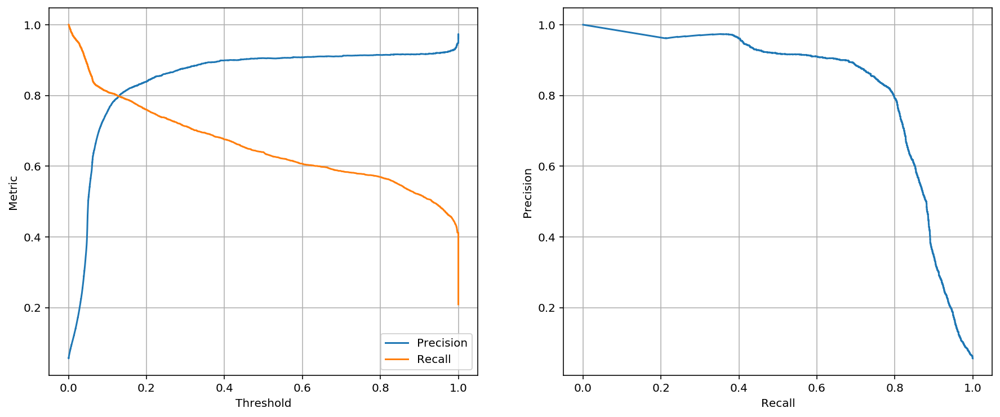

In [135]:
fig, axes = plt.subplots(1,2, figsize=(15,6))

axes[0].plot(thrs, precs[:-1], label='Precision')
axes[0].plot(thrs, recs[:-1], label="Recall")
axes[0].set(xlabel="Threshold", ylabel="Metric")
axes[0].legend()
axes[0].grid()

axes[1].plot(recs, precs)
axes[1].set(xlabel="Recall", ylabel="Precision")
axes[1].grid()

In [128]:
Exam_Preds = clf.predict_proba(Exam_X)

In [129]:
sens_name_1 = Exam_X.columns[12]
sens_name_2 = Exam_X.columns[13]

Sens_1 = Exam_X[sens_name_1].values
Sens_2 = Exam_X[sens_name_2].values

Shifted_Target = Exam_y.values

fig = go.Figure()
# fig.add_trace(go.Scatter(x=Exam_X.index, y=Sens_1, name="Вибрация ЗПД (осев.)"))
fig.add_trace(go.Scatter(x=Exam_X.index, y=Shifted_Target, name="Target"))
fig.add_trace(go.Scatter(x=Exam_X.index, y=Exam_Preds[:,1], name="Exam Preds"))

#==========================================================================================#

# fig.update_xaxes(rangeslider_visible=True)
fig.show(config=config)
# fig.write_html("March_Stops_Example.html", config=config)

In [136]:
precs, recs, thrs = precision_recall_curve(Exam_y, Exam_Preds[:,1])

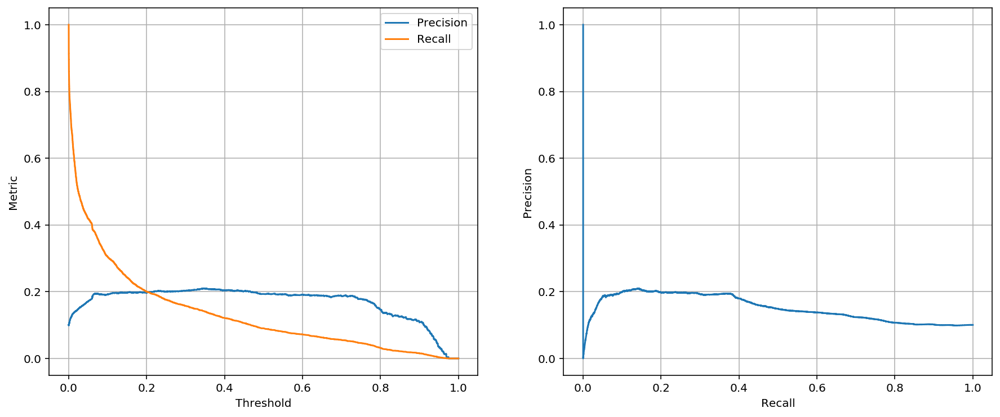

In [137]:
fig, axes = plt.subplots(1,2, figsize=(15,6))

axes[0].plot(thrs, precs[:-1], label='Precision')
axes[0].plot(thrs, recs[:-1], label="Recall")
axes[0].set(xlabel="Threshold", ylabel="Metric")
axes[0].legend()
axes[0].grid()

axes[1].plot(recs, precs)
axes[1].set(xlabel="Recall", ylabel="Precision")
axes[1].grid()

---

In [91]:
from ipywidgets import interact, interact_manual

@interact
def plot(SensName_1 = Val_X.columns,
         SensName_2 = Val_X.columns):
    sens0, sens1 = Val_X[SensName_1].values[2000:3000], Val_X[SensName_2].values[2000:3000]

    min0, max0, min1, max1 = sens0.min(), sens0.max(), sens1.min(), sens1.max()

    x0, x1 = np.meshgrid(np.linspace(min0, max0, 100), np.linspace(min1, max1, 100))
    x = np.array([x0, x1]).reshape(2, -1).T


    plt.figure(figsize=(14,12))
    plt.scatter(sens0, sens1, s=40, c=Val_y.values[2000:3000], marker="x")
    # plt.contourf(x0, x1, model.predict_proba(x)[:, 1].reshape(100, 100), np.linspace(0, 1, 5), alpha=0.2)

    plt.colorbar()
    # plt.xlim(-4, 4)
    # plt.ylim(-4, 4)
    plt.gca().set_aspect("equal", adjustable="box")

interactive(children=(Dropdown(description='SensName_1', options=('Температура обмотки статора А (датчик №1)',…

## RVM

In [100]:
from sklearn_rvm import EMRVC

In [107]:
clf = EMRVC(verbose=1)

In [109]:
Val_Preds = clf.predict_proba(Val_X)

In [110]:
import plotly.graph_objects as go
import plotly.express as px

config = dict({'scrollZoom': True})

sens_name_1 = Val_X.columns[12]
sens_name_2 = Val_X.columns[13]

Sens_1 = Val_X[sens_name_1].values
Sens_2 = Val_X[sens_name_2].values

Shifted_Target = Val_y.values

fig = go.Figure()
# fig.add_trace(go.Scatter(x=Val_X.index, y=Sens_1, name="Вибрация ЗПД (осев.)"))
fig.add_trace(go.Scatter(x=Val_X.index, y=Shifted_Target, name="Target"))
fig.add_trace(go.Scatter(x=Val_X.index, y=Val_Preds[:,1], name="Val Preds"))

#==========================================================================================#

# fig.update_xaxes(rangeslider_visible=True)
fig.show(config=config)
# fig.write_html("March_Stops_Example.html", config=config)